In [1]:
import ee
import geemap
import os
import numpy as np
import matplotlib.pyplot as plt
import rasterio
import cv2

# remover componentes muito pequenos nas máscaras:
from scipy.ndimage import label, generate_binary_structure

ee.Authenticate()

True

In [4]:
# Inicializa a conta do Earth Engine
ee.Initialize(project='ee-rateiogepeto')

In [12]:
dataset_dir = '../data/dataset_sentinel/'
os.makedirs(dataset_dir, exist_ok=True)

# Máscaras ficarão dentro do mesmo TIFF baixado
mask_dir = os.path.join(dataset_dir, 'masks')
os.makedirs(mask_dir, exist_ok=True)

In [13]:
aois = [
    ee.Geometry.Rectangle([-47.95, -15.83, -47.91, -15.79]),  # Brasília (~4km x ~4km)
    ee.Geometry.Rectangle([-43.22, -22.95, -43.18, -22.91]),  # Rio de Janeiro
    ee.Geometry.Rectangle([-46.75, -23.60, -46.71, -23.56]),  # São Paulo
]

In [14]:
def merge_s2_and_cloud_prob(s2_sr_col, s2_cp_col):
    """
    Faz um 'join' entre a coleção Sentinel-2 SR e a coleção de cloud probability,
    de modo que cada imagem S2 SR tenha a banda "probability" correspondente.
    Retorna uma coleção de imagens combinadas (com bandas de reflectância e banda 'probability').
    """

    # Define o tipo de join: INNER_JOIN
    inner_join = ee.Join.inner()

    # Define como iremos parear as imagens (por data, +/- 1 hora, por exemplo)
    # As coleções do Sentinel-2 têm propriedades "system:time_start".
    filter_time_eq = ee.Filter.equals(
        leftField='system:index',
        rightField='system:index'
    )

    # Aplica o join
    joined_collection = inner_join.apply(s2_sr_col, s2_cp_col, filter_time_eq)

    def merge_bands(feature):
        """
        Recebe um ee.Feature com .get('primary') e .get('secondary'),
        que são imagens. Retorna a imagem mesclada (todas as bandas + cloud_probability).
        """
        primary = ee.Image(feature.get('primary'))
        secondary = ee.Image(feature.get('secondary'))
        # A banda do cloud probability se chama 'probability' (0 a 100)
        combined = primary.addBands(secondary.select('probability'))
        return combined

    return joined_collection.map(merge_bands)


def generate_cloud_shadow_masks_sentinel2(image, cloud_prob_threshold=50):
    """
    Retorna duas bandas binárias (cloud_mask, shadow_mask) combinando:
      - Banda SCL (Scene Classification)
      - Banda 'probability' (0-100) da coleção COPERNICUS/S2_CLOUD_PROBABILITY
    """
    # Extrai as bandas necessárias
    scl = image.select('SCL')
    cloud_prob = image.select('probability')  # banda adicionada pelo join

    # ---------------------------------------------------------------------------------
    # 1) NUVEM A PARTIR DO SCL
    #    SCL = 8 (CLOUD_MEDIUM_PROBA)
    #        = 9 (CLOUD_HIGH_PROBA)
    #        = 10 (THIN_CIRRUS)
    #        = 11 (SNOW/ICE) - muitas vezes tratada como nuvem
    # ---------------------------------------------------------------------------------
    cloud_mask_scl = scl.eq(8).Or(scl.eq(9)).Or(scl.eq(10)).Or(scl.eq(11))

    # 2) NUVEM A PARTIR DO CLOUD PROBABILITY
    cloud_mask_prob = cloud_prob.gt(cloud_prob_threshold)

    # Combina com OR (seja SCL OU probabilidade indica nuvem)
    final_cloud_mask = cloud_mask_scl.Or(cloud_mask_prob).rename("cloud_mask")

    # ---------------------------------------------------------------------------------
    # 3) SOMBRA DE NUVEM A PARTIR DO SCL
    #    SCL = 3 (CLOUD_SHADOW)
    # ---------------------------------------------------------------------------------
    shadow_mask = scl.eq(3).rename("shadow_mask")

    return final_cloud_mask, shadow_mask


def download_sentinel_image_with_masks(image, aoi, output_dir, image_id, cloud_prob_threshold=50):
    """
    - Seleciona B2,B3,B4,B8,SCL, + probability (já deve estar presente no 'image' após join).
    - Cria as bandas de máscara (cloud_mask, shadow_mask).
    - Exporta tudo para um único TIFF.
    - Retorna o caminho do arquivo salvo.
    """

    # Selecione as bandas de interesse (note que 'probability' já está junto da imagem)
    # Mantemos 'probability' pois pode ser útil para análises futuras.
    base_bands = ['B2','B3','B4','B8','SCL','probability']
    image = image.select(base_bands)

    # Gera as máscaras
    cloud_mask, shadow_mask = generate_cloud_shadow_masks_sentinel2(image, cloud_prob_threshold)

    # Adiciona as bandas de máscara na imagem
    image_with_masks = image.addBands([cloud_mask, shadow_mask])

    # Nome do arquivo de saída
    filename = os.path.join(output_dir, f'sentinel_{image_id}.tif')
    filename = os.path.normpath(filename)

    # Exporta (faz o download) de todas as bandas em um só arquivo
    geemap.ee_export_image(
        image_with_masks,
        filename=filename,
        scale=10,
        region=aoi.getInfo()['coordinates'],
        file_per_band=False
    )

    return filename


def remove_small_components(mask_array, min_size=8):
    """
    Remove componentes (blobs) menores que 'min_size' pixels usando scipy.ndimage.label.
    'mask_array' é um np.array binário (0 ou 1).
    Retorna um np.array binário (0 ou 1) sem os componentes pequenos.
    """
    # Estrutura de conexidade 8
    structure = generate_binary_structure(2, 2)
    labeled, ncomponents = label(mask_array, structure=structure)

    # Para cada componente, se o número de pixels < min_size, zere no resultado
    output = np.copy(mask_array)
    for comp_id in range(1, ncomponents + 1):
        component_mask = (labeled == comp_id)
        if np.sum(component_mask) < min_size:
            output[component_mask] = 0

    return output


def visualize_masks(image_file, remove_components=True, min_size=8):
    """
    Lê o TIFF (que já contém B2,B3,B4,B8,SCL,probability,cloud_mask,shadow_mask),
    gera RGB (B4,B3,B2) e aplica operação morfológica e/ou remoção de componentes na nuvem e sombra.
    """

    with rasterio.open(image_file) as src:
        # A ordem depende de como adicionamos as bandas:
        #  1 = B2
        #  2 = B3
        #  3 = B4
        #  4 = B8
        #  5 = SCL
        #  6 = probability
        #  7 = cloud_mask
        #  8 = shadow_mask
        # Ajuste se mudou a ordem na exportação.

        b4 = src.read(3).astype(np.float32)
        b3 = src.read(2).astype(np.float32)
        b2 = src.read(1).astype(np.float32)

        cloud_mask = src.read(7)
        shadow_mask = src.read(8)

    # Normalização simples para visualização
    rgb = np.stack([b4, b3, b2], axis=-1)
    max_val = np.max(rgb)
    if max_val > 0:
        rgb /= max_val

    # 1) Binarização (se necessário)
    cloud_mask = (cloud_mask > 0).astype(np.uint8)
    shadow_mask = (shadow_mask > 0).astype(np.uint8)

    # 2) (Opcional) Remover componentes pequenos
    if remove_components:
        cloud_mask = remove_small_components(cloud_mask, min_size=min_size)
        shadow_mask = remove_small_components(shadow_mask, min_size=min_size)

    # 3) Operação morfológica para "limpar" ruídos
    kernel = np.ones((3,3), np.uint8)
    cloud_mask = cv2.morphologyEx(cloud_mask, cv2.MORPH_OPEN, kernel)
    shadow_mask = cv2.morphologyEx(shadow_mask, cv2.MORPH_OPEN, kernel)

    # Visualiza
    fig, axes = plt.subplots(1, 3, figsize=(18, 6))
    axes[0].imshow(rgb)
    axes[0].set_title('RGB (B4,B3,B2)')
    axes[0].axis('off')

    axes[1].imshow(cloud_mask, cmap='Reds')
    axes[1].set_title('Máscara de Nuvem (final)')
    axes[1].axis('off')

    axes[2].imshow(shadow_mask, cmap='Blues')
    axes[2].set_title('Máscara de Sombra (final)')
    axes[2].axis('off')

    plt.tight_layout()
    plt.show()



Processando AOI 1/3: {"type": "Polygon", "coordinates": [[[-47.95, -15.79], [-47.95, -15.83], [-47.91, -15.83], [-47.91, -15.79]]], "evenOdd": true}
  -> Total de imagens pareadas = 88
     -> Processando imagem 1/88, ID: S2B_MSIL2A_20210109T132229_N0214_R038_T22LHH_20210109T153814
Generating URL ...
Please wait ...
Data downloaded to c:\Users\arthu\Documents\pibic\data\dataset_sentinel\sentinel_S2B_MSIL2A_20210109T132229_N0214_R038_T22LHH_20210109T153814.tif
       [OK] Imagem salva em: ..\data\dataset_sentinel\sentinel_S2B_MSIL2A_20210109T132229_N0214_R038_T22LHH_20210109T153814.tif


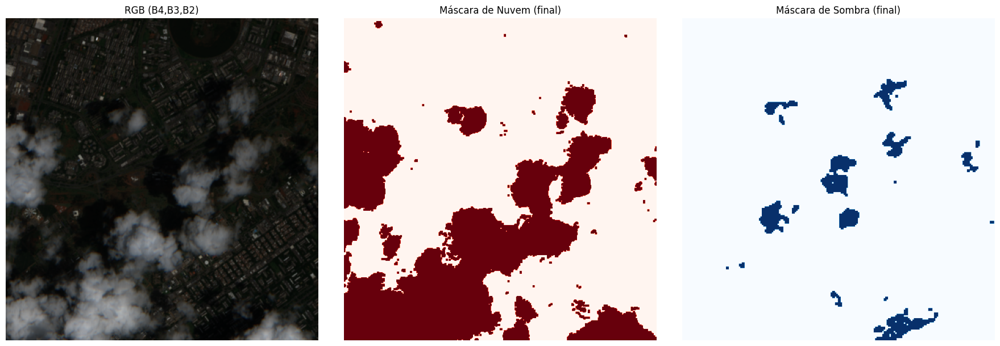

     -> Processando imagem 2/88, ID: S2B_MSIL2A_20210119T132229_N0214_R038_T22LHH_20210119T153734
Generating URL ...
Please wait ...
Data downloaded to c:\Users\arthu\Documents\pibic\data\dataset_sentinel\sentinel_S2B_MSIL2A_20210119T132229_N0214_R038_T22LHH_20210119T153734.tif
       [OK] Imagem salva em: ..\data\dataset_sentinel\sentinel_S2B_MSIL2A_20210119T132229_N0214_R038_T22LHH_20210119T153734.tif


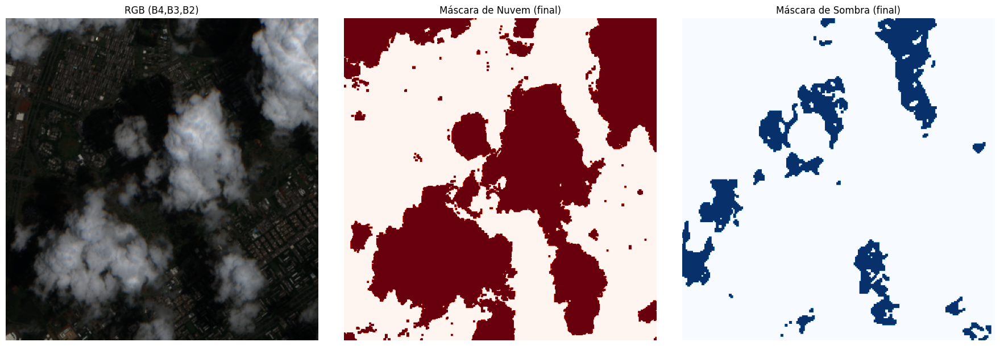

     -> Processando imagem 3/88, ID: S2A_MSIL2A_20210124T132231_N0214_R038_T22LHH_20210124T154400
Generating URL ...
Please wait ...
Data downloaded to c:\Users\arthu\Documents\pibic\data\dataset_sentinel\sentinel_S2A_MSIL2A_20210124T132231_N0214_R038_T22LHH_20210124T154400.tif
       [OK] Imagem salva em: ..\data\dataset_sentinel\sentinel_S2A_MSIL2A_20210124T132231_N0214_R038_T22LHH_20210124T154400.tif


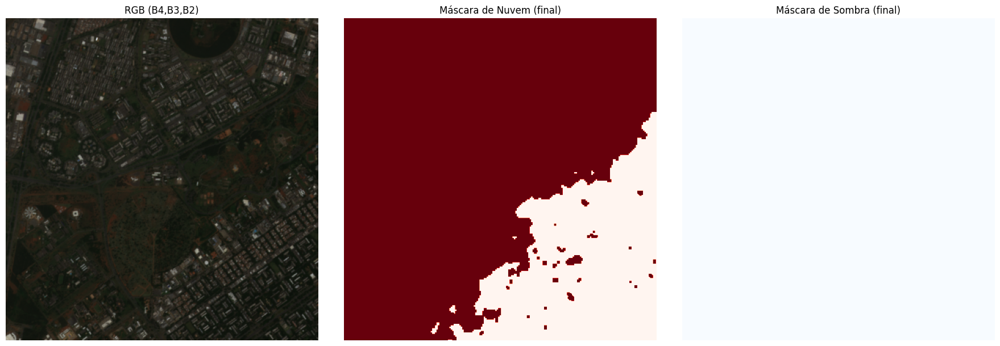

     -> Processando imagem 4/88, ID: S2A_MSIL2A_20210127T133231_N0214_R081_T22LHH_20210127T155442
Generating URL ...
Please wait ...
Data downloaded to c:\Users\arthu\Documents\pibic\data\dataset_sentinel\sentinel_S2A_MSIL2A_20210127T133231_N0214_R081_T22LHH_20210127T155442.tif
       [OK] Imagem salva em: ..\data\dataset_sentinel\sentinel_S2A_MSIL2A_20210127T133231_N0214_R081_T22LHH_20210127T155442.tif


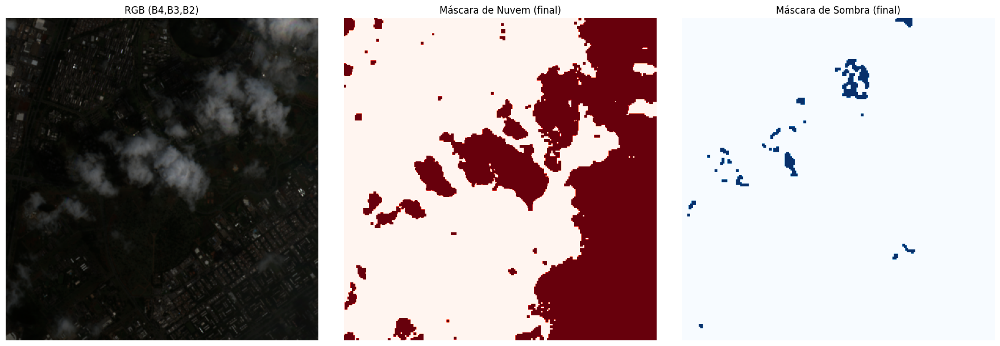

     -> Processando imagem 5/88, ID: S2B_MSIL2A_20210129T132229_N0214_R038_T22LHH_20210129T154600
Generating URL ...
Please wait ...
Data downloaded to c:\Users\arthu\Documents\pibic\data\dataset_sentinel\sentinel_S2B_MSIL2A_20210129T132229_N0214_R038_T22LHH_20210129T154600.tif
       [OK] Imagem salva em: ..\data\dataset_sentinel\sentinel_S2B_MSIL2A_20210129T132229_N0214_R038_T22LHH_20210129T154600.tif


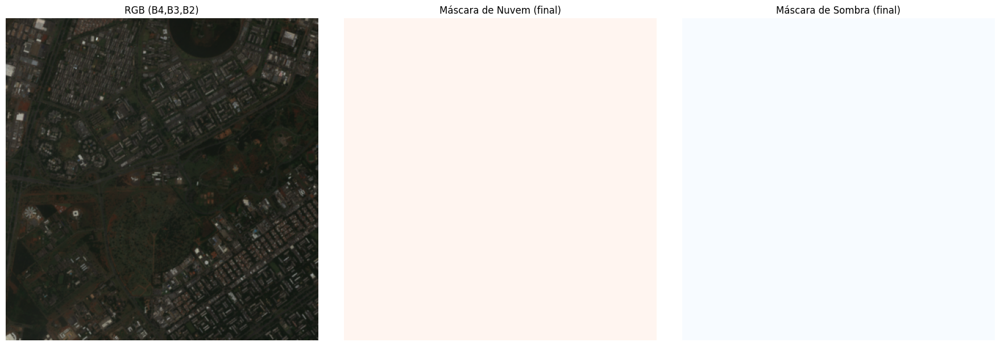

     -> Processando imagem 6/88, ID: S2B_MSIL2A_20210201T133229_N0214_R081_T22LHH_20210201T155134
Generating URL ...
Please wait ...
Data downloaded to c:\Users\arthu\Documents\pibic\data\dataset_sentinel\sentinel_S2B_MSIL2A_20210201T133229_N0214_R081_T22LHH_20210201T155134.tif
       [OK] Imagem salva em: ..\data\dataset_sentinel\sentinel_S2B_MSIL2A_20210201T133229_N0214_R081_T22LHH_20210201T155134.tif


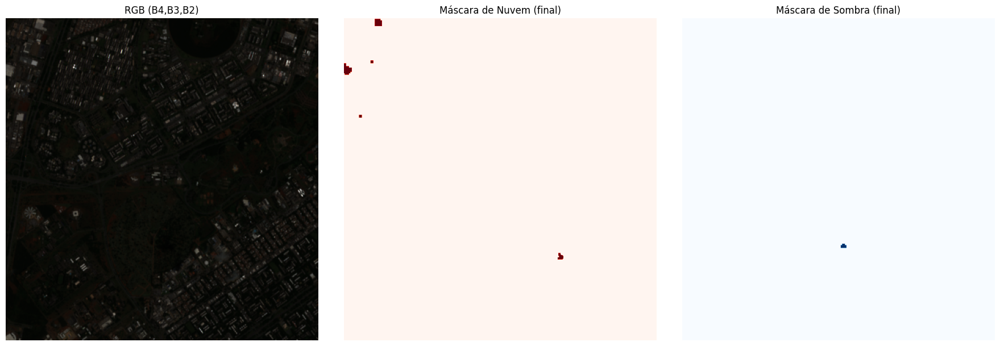

     -> Processando imagem 7/88, ID: S2A_MSIL2A_20210203T132231_N0214_R038_T22LHH_20210203T154538
Generating URL ...
Please wait ...
Data downloaded to c:\Users\arthu\Documents\pibic\data\dataset_sentinel\sentinel_S2A_MSIL2A_20210203T132231_N0214_R038_T22LHH_20210203T154538.tif
       [OK] Imagem salva em: ..\data\dataset_sentinel\sentinel_S2A_MSIL2A_20210203T132231_N0214_R038_T22LHH_20210203T154538.tif


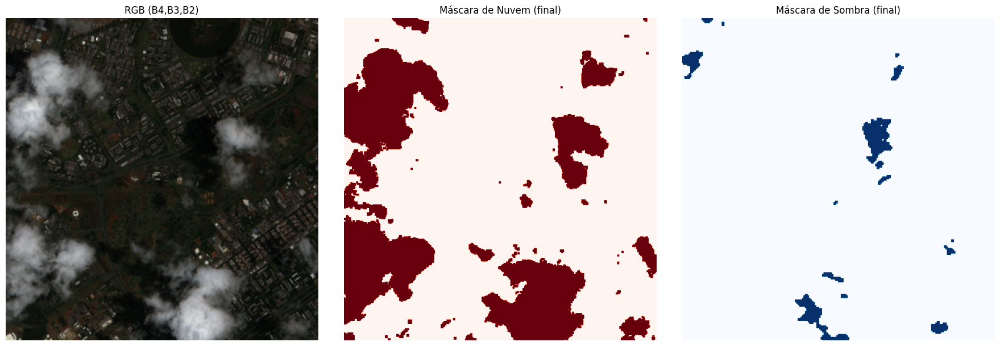

     -> Processando imagem 8/88, ID: S2A_MSIL2A_20210223T132231_N0214_R038_T22LHH_20210223T154640
Generating URL ...
Please wait ...
Data downloaded to c:\Users\arthu\Documents\pibic\data\dataset_sentinel\sentinel_S2A_MSIL2A_20210223T132231_N0214_R038_T22LHH_20210223T154640.tif
       [OK] Imagem salva em: ..\data\dataset_sentinel\sentinel_S2A_MSIL2A_20210223T132231_N0214_R038_T22LHH_20210223T154640.tif


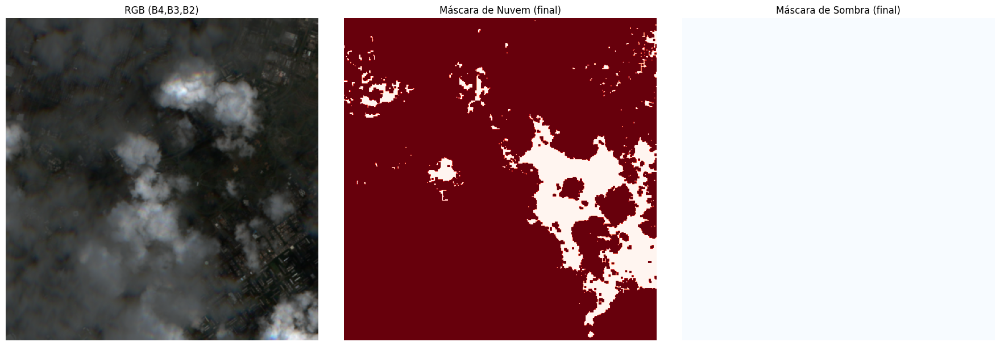

     -> Processando imagem 9/88, ID: S2B_MSIL2A_20210303T133229_N0214_R081_T22LHH_20210303T155437
Generating URL ...
Please wait ...
Data downloaded to c:\Users\arthu\Documents\pibic\data\dataset_sentinel\sentinel_S2B_MSIL2A_20210303T133229_N0214_R081_T22LHH_20210303T155437.tif
       [OK] Imagem salva em: ..\data\dataset_sentinel\sentinel_S2B_MSIL2A_20210303T133229_N0214_R081_T22LHH_20210303T155437.tif


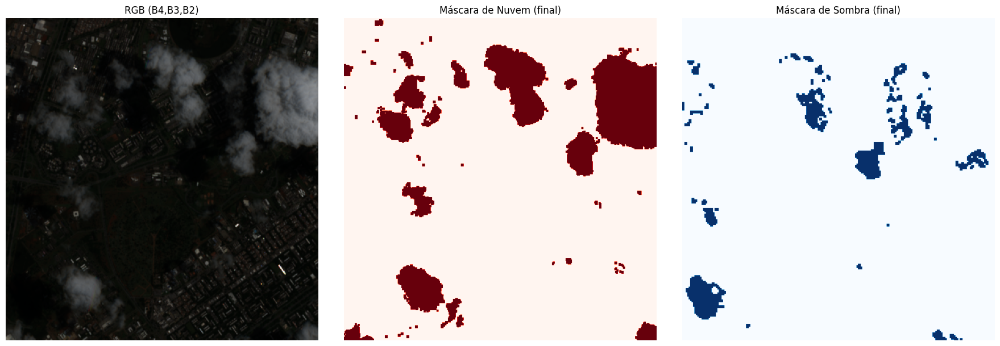

     -> Processando imagem 10/88, ID: S2A_MSIL2A_20210305T132231_N0214_R038_T22LHH_20210305T154623
Generating URL ...
Please wait ...
Data downloaded to c:\Users\arthu\Documents\pibic\data\dataset_sentinel\sentinel_S2A_MSIL2A_20210305T132231_N0214_R038_T22LHH_20210305T154623.tif
       [OK] Imagem salva em: ..\data\dataset_sentinel\sentinel_S2A_MSIL2A_20210305T132231_N0214_R038_T22LHH_20210305T154623.tif


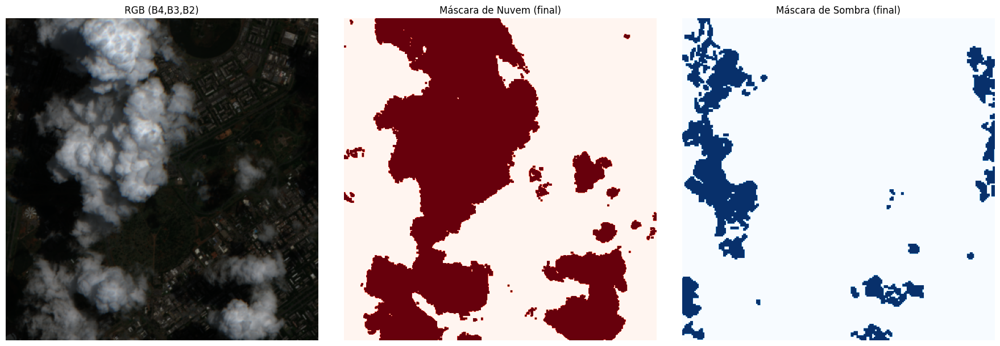

     -> Processando imagem 11/88, ID: S2A_MSIL2A_20210315T132231_N0214_R038_T22LHH_20210315T154742
Generating URL ...
Please wait ...
Data downloaded to c:\Users\arthu\Documents\pibic\data\dataset_sentinel\sentinel_S2A_MSIL2A_20210315T132231_N0214_R038_T22LHH_20210315T154742.tif
       [OK] Imagem salva em: ..\data\dataset_sentinel\sentinel_S2A_MSIL2A_20210315T132231_N0214_R038_T22LHH_20210315T154742.tif


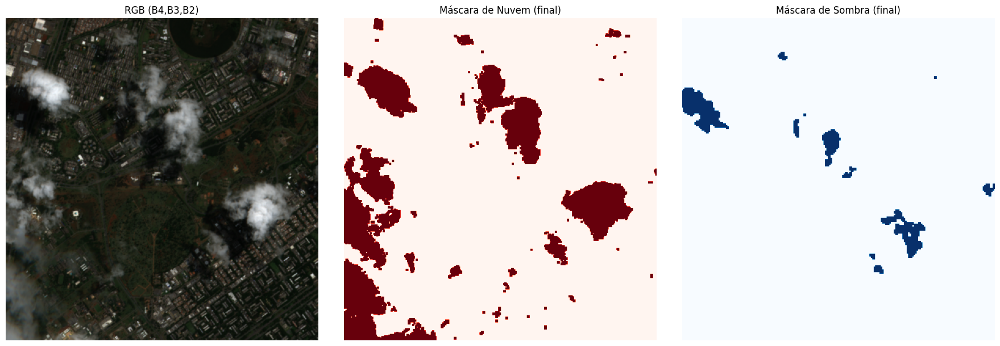

     -> Processando imagem 12/88, ID: S2B_MSIL2A_20210320T132229_N0214_R038_T22LHH_20210320T154459
Generating URL ...
Please wait ...
Data downloaded to c:\Users\arthu\Documents\pibic\data\dataset_sentinel\sentinel_S2B_MSIL2A_20210320T132229_N0214_R038_T22LHH_20210320T154459.tif
       [OK] Imagem salva em: ..\data\dataset_sentinel\sentinel_S2B_MSIL2A_20210320T132229_N0214_R038_T22LHH_20210320T154459.tif


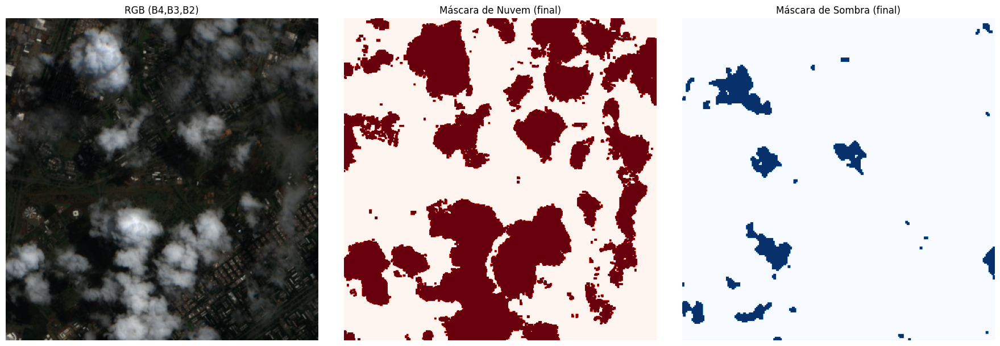

     -> Processando imagem 13/88, ID: S2A_MSIL2A_20210325T132231_N0214_R038_T22LHH_20210325T171544
Generating URL ...
Please wait ...
Data downloaded to c:\Users\arthu\Documents\pibic\data\dataset_sentinel\sentinel_S2A_MSIL2A_20210325T132231_N0214_R038_T22LHH_20210325T171544.tif
       [OK] Imagem salva em: ..\data\dataset_sentinel\sentinel_S2A_MSIL2A_20210325T132231_N0214_R038_T22LHH_20210325T171544.tif


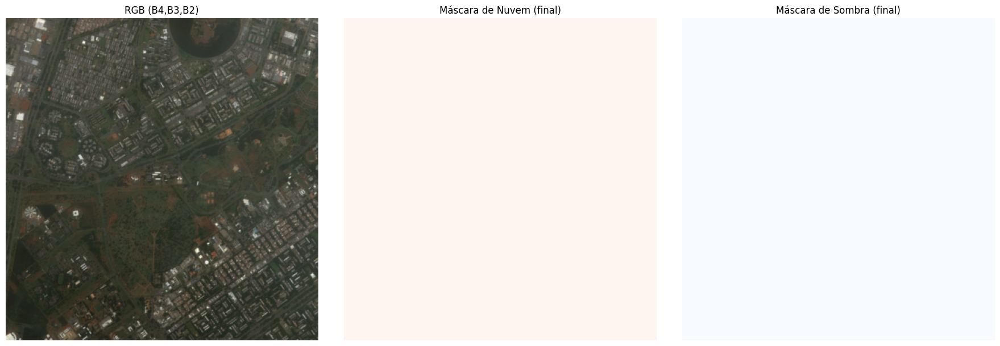

     -> Processando imagem 14/88, ID: S2A_MSIL2A_20210328T133221_N0214_R081_T22LHH_20210328T172739
Generating URL ...
Please wait ...
Data downloaded to c:\Users\arthu\Documents\pibic\data\dataset_sentinel\sentinel_S2A_MSIL2A_20210328T133221_N0214_R081_T22LHH_20210328T172739.tif
       [OK] Imagem salva em: ..\data\dataset_sentinel\sentinel_S2A_MSIL2A_20210328T133221_N0214_R081_T22LHH_20210328T172739.tif


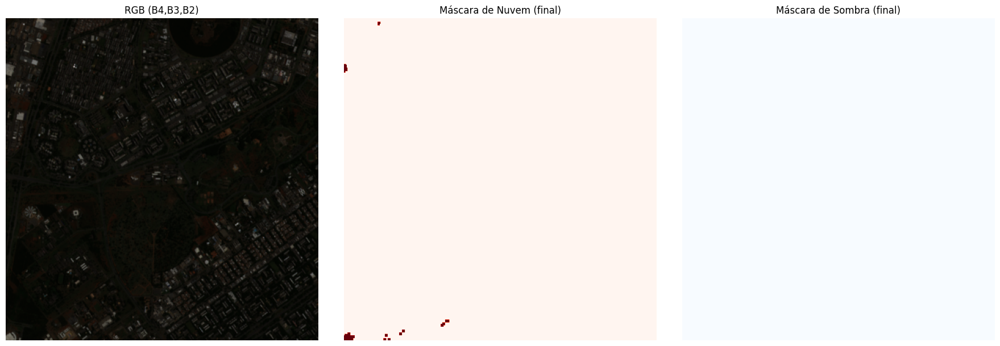

     -> Processando imagem 15/88, ID: S2B_MSIL2A_20210330T132229_N0300_R038_T22LHH_20210330T154511
Generating URL ...
Please wait ...
Data downloaded to c:\Users\arthu\Documents\pibic\data\dataset_sentinel\sentinel_S2B_MSIL2A_20210330T132229_N0300_R038_T22LHH_20210330T154511.tif
       [OK] Imagem salva em: ..\data\dataset_sentinel\sentinel_S2B_MSIL2A_20210330T132229_N0300_R038_T22LHH_20210330T154511.tif


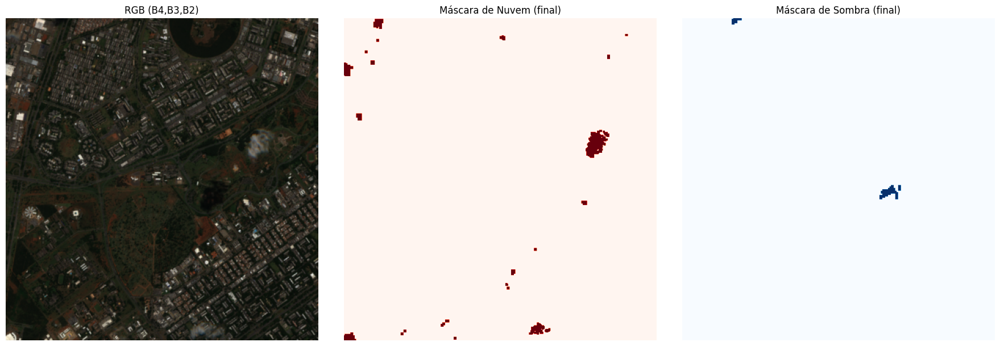

     -> Processando imagem 16/88, ID: S2A_MSIL2A_20210404T132231_N0300_R038_T22LHH_20210404T171841
Generating URL ...
Please wait ...
Data downloaded to c:\Users\arthu\Documents\pibic\data\dataset_sentinel\sentinel_S2A_MSIL2A_20210404T132231_N0300_R038_T22LHH_20210404T171841.tif
       [OK] Imagem salva em: ..\data\dataset_sentinel\sentinel_S2A_MSIL2A_20210404T132231_N0300_R038_T22LHH_20210404T171841.tif


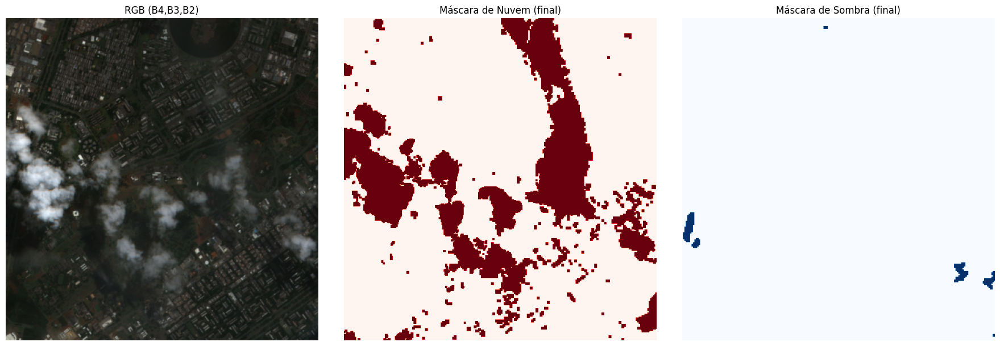

     -> Processando imagem 17/88, ID: S2B_MSIL2A_20210412T133219_N0300_R081_T22LHH_20210412T155000
Generating URL ...
Please wait ...
Data downloaded to c:\Users\arthu\Documents\pibic\data\dataset_sentinel\sentinel_S2B_MSIL2A_20210412T133219_N0300_R081_T22LHH_20210412T155000.tif
       [OK] Imagem salva em: ..\data\dataset_sentinel\sentinel_S2B_MSIL2A_20210412T133219_N0300_R081_T22LHH_20210412T155000.tif


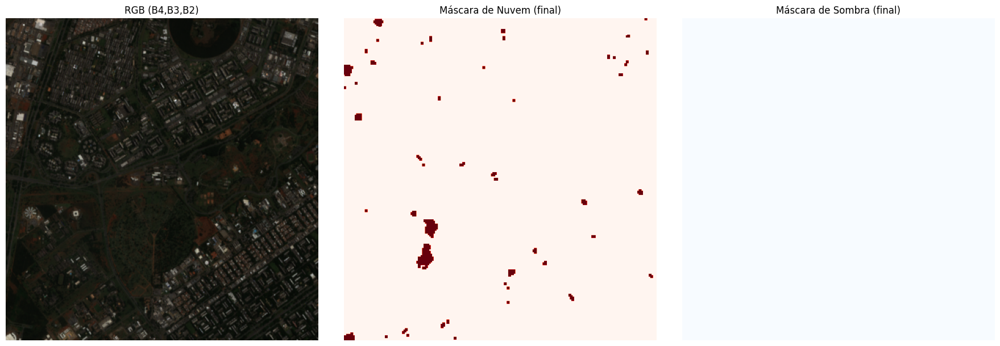

     -> Processando imagem 18/88, ID: S2A_MSIL2A_20210414T132231_N0300_R038_T22LHH_20210414T171323
Generating URL ...
Please wait ...
Data downloaded to c:\Users\arthu\Documents\pibic\data\dataset_sentinel\sentinel_S2A_MSIL2A_20210414T132231_N0300_R038_T22LHH_20210414T171323.tif
       [OK] Imagem salva em: ..\data\dataset_sentinel\sentinel_S2A_MSIL2A_20210414T132231_N0300_R038_T22LHH_20210414T171323.tif


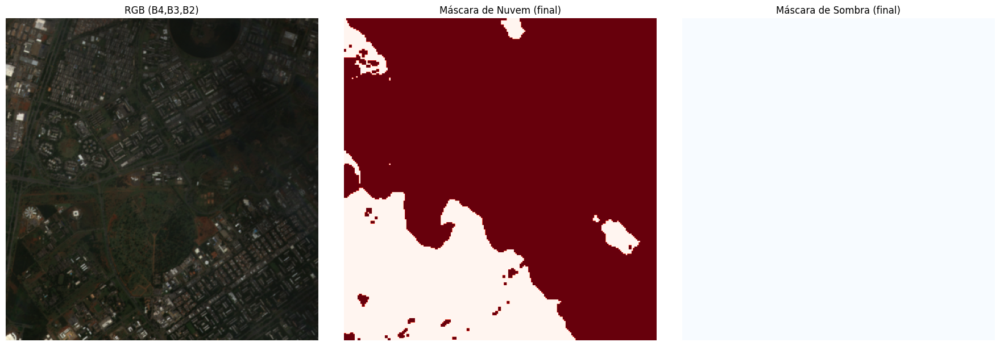

     -> Processando imagem 19/88, ID: S2A_MSIL2A_20210417T133221_N0300_R081_T22LHH_20210417T154451
Generating URL ...
Please wait ...
Data downloaded to c:\Users\arthu\Documents\pibic\data\dataset_sentinel\sentinel_S2A_MSIL2A_20210417T133221_N0300_R081_T22LHH_20210417T154451.tif
       [OK] Imagem salva em: ..\data\dataset_sentinel\sentinel_S2A_MSIL2A_20210417T133221_N0300_R081_T22LHH_20210417T154451.tif


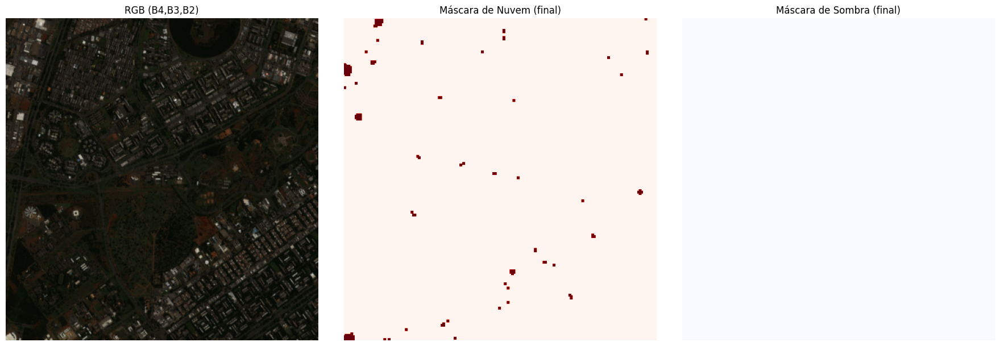

     -> Processando imagem 20/88, ID: S2B_MSIL2A_20210419T132229_N0300_R038_T22LHH_20210419T153722
Generating URL ...
Please wait ...
Data downloaded to c:\Users\arthu\Documents\pibic\data\dataset_sentinel\sentinel_S2B_MSIL2A_20210419T132229_N0300_R038_T22LHH_20210419T153722.tif
       [OK] Imagem salva em: ..\data\dataset_sentinel\sentinel_S2B_MSIL2A_20210419T132229_N0300_R038_T22LHH_20210419T153722.tif


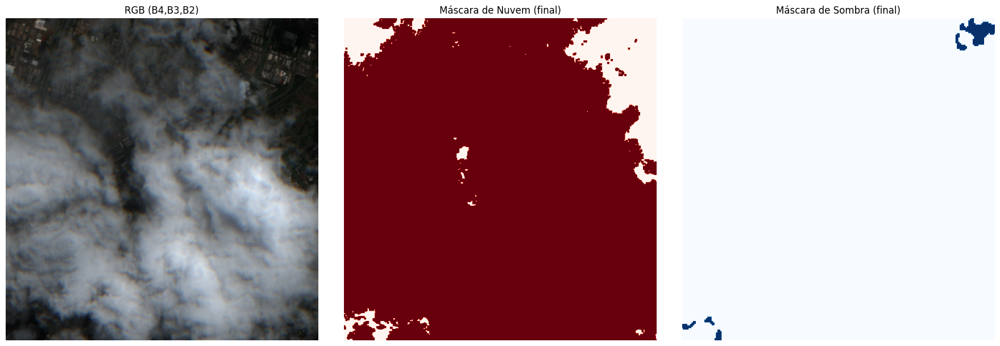

     -> Processando imagem 21/88, ID: S2B_MSIL2A_20210422T133219_N0300_R081_T22LHH_20210422T154725
Generating URL ...
Please wait ...
Data downloaded to c:\Users\arthu\Documents\pibic\data\dataset_sentinel\sentinel_S2B_MSIL2A_20210422T133219_N0300_R081_T22LHH_20210422T154725.tif
       [OK] Imagem salva em: ..\data\dataset_sentinel\sentinel_S2B_MSIL2A_20210422T133219_N0300_R081_T22LHH_20210422T154725.tif


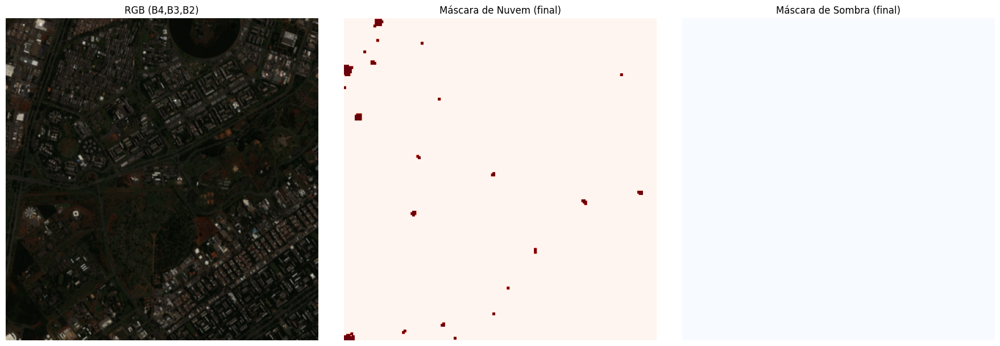

     -> Processando imagem 22/88, ID: S2A_MSIL2A_20210424T132231_N0300_R038_T22LHH_20210424T171549
Generating URL ...
Please wait ...
Data downloaded to c:\Users\arthu\Documents\pibic\data\dataset_sentinel\sentinel_S2A_MSIL2A_20210424T132231_N0300_R038_T22LHH_20210424T171549.tif
       [OK] Imagem salva em: ..\data\dataset_sentinel\sentinel_S2A_MSIL2A_20210424T132231_N0300_R038_T22LHH_20210424T171549.tif


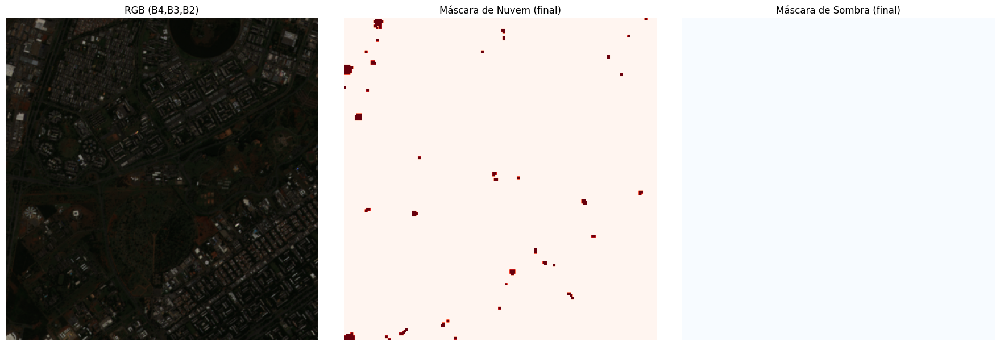

     -> Processando imagem 23/88, ID: S2A_MSIL2A_20210427T133221_N0300_R081_T22LHH_20210427T154529
Generating URL ...
Please wait ...
Data downloaded to c:\Users\arthu\Documents\pibic\data\dataset_sentinel\sentinel_S2A_MSIL2A_20210427T133221_N0300_R081_T22LHH_20210427T154529.tif
       [OK] Imagem salva em: ..\data\dataset_sentinel\sentinel_S2A_MSIL2A_20210427T133221_N0300_R081_T22LHH_20210427T154529.tif


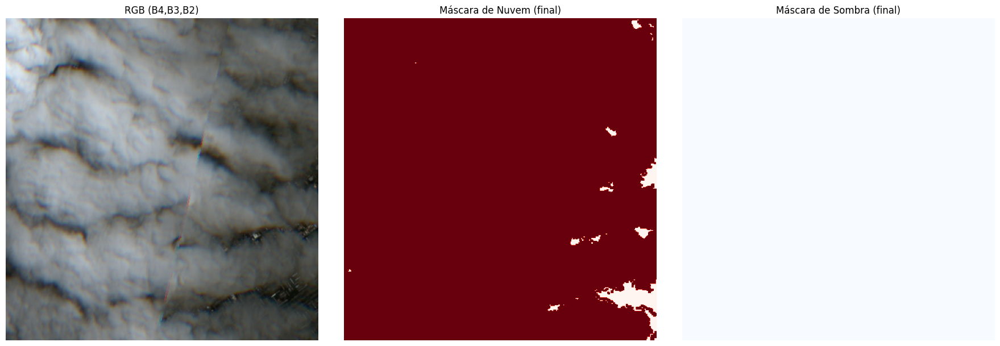

     -> Processando imagem 24/88, ID: S2A_MSIL2A_20210504T132231_N0300_R038_T22LHH_20210504T171521
Generating URL ...
Please wait ...
Data downloaded to c:\Users\arthu\Documents\pibic\data\dataset_sentinel\sentinel_S2A_MSIL2A_20210504T132231_N0300_R038_T22LHH_20210504T171521.tif
       [OK] Imagem salva em: ..\data\dataset_sentinel\sentinel_S2A_MSIL2A_20210504T132231_N0300_R038_T22LHH_20210504T171521.tif


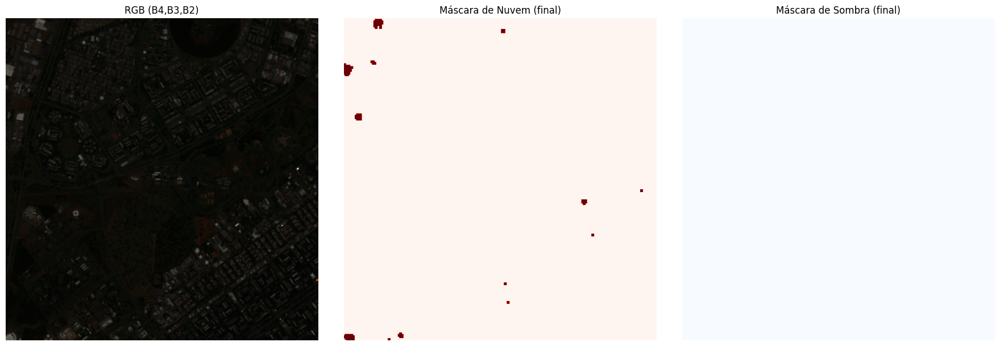

     -> Processando imagem 25/88, ID: S2A_MSIL2A_20210507T133221_N0300_R081_T22LHH_20210507T154237
Generating URL ...
Please wait ...
Data downloaded to c:\Users\arthu\Documents\pibic\data\dataset_sentinel\sentinel_S2A_MSIL2A_20210507T133221_N0300_R081_T22LHH_20210507T154237.tif
       [OK] Imagem salva em: ..\data\dataset_sentinel\sentinel_S2A_MSIL2A_20210507T133221_N0300_R081_T22LHH_20210507T154237.tif


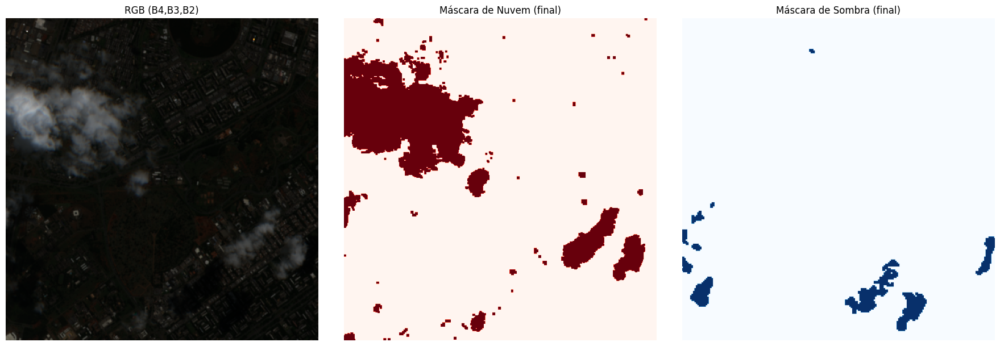

     -> Processando imagem 26/88, ID: S2B_MSIL2A_20210509T132229_N0300_R038_T22LHH_20210509T153805
Generating URL ...
Please wait ...
Data downloaded to c:\Users\arthu\Documents\pibic\data\dataset_sentinel\sentinel_S2B_MSIL2A_20210509T132229_N0300_R038_T22LHH_20210509T153805.tif
       [OK] Imagem salva em: ..\data\dataset_sentinel\sentinel_S2B_MSIL2A_20210509T132229_N0300_R038_T22LHH_20210509T153805.tif


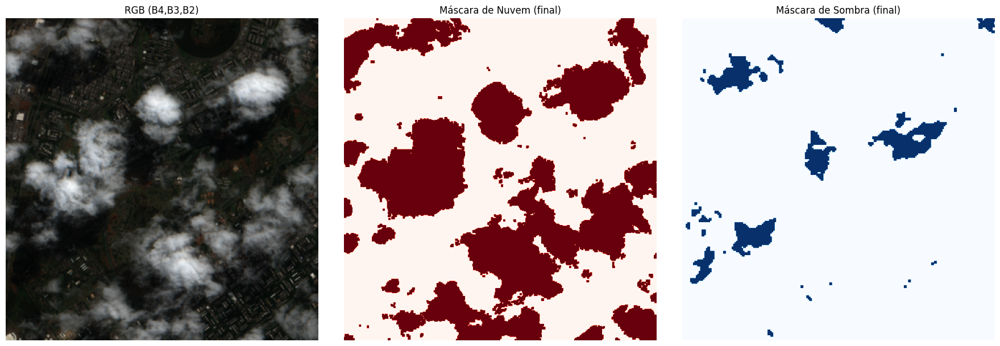

     -> Processando imagem 27/88, ID: S2B_MSIL2A_20210512T133229_N0300_R081_T22LHH_20210512T155705
Generating URL ...
Please wait ...
Data downloaded to c:\Users\arthu\Documents\pibic\data\dataset_sentinel\sentinel_S2B_MSIL2A_20210512T133229_N0300_R081_T22LHH_20210512T155705.tif
       [OK] Imagem salva em: ..\data\dataset_sentinel\sentinel_S2B_MSIL2A_20210512T133229_N0300_R081_T22LHH_20210512T155705.tif


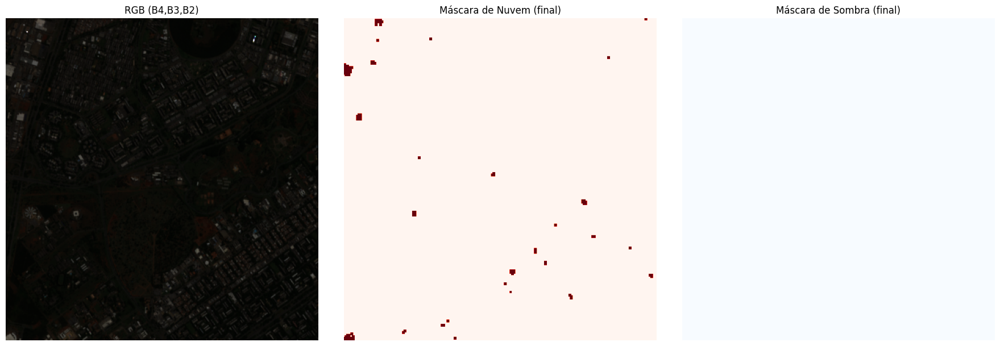

     -> Processando imagem 28/88, ID: S2A_MSIL2A_20210514T132231_N0300_R038_T22LHH_20210514T172621
Generating URL ...
Please wait ...
Data downloaded to c:\Users\arthu\Documents\pibic\data\dataset_sentinel\sentinel_S2A_MSIL2A_20210514T132231_N0300_R038_T22LHH_20210514T172621.tif
       [OK] Imagem salva em: ..\data\dataset_sentinel\sentinel_S2A_MSIL2A_20210514T132231_N0300_R038_T22LHH_20210514T172621.tif


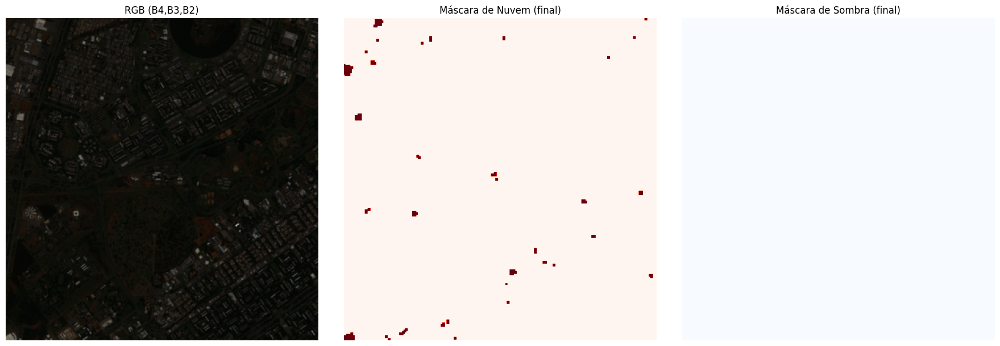

     -> Processando imagem 29/88, ID: S2B_MSIL2A_20210519T132229_N0300_R038_T22LHH_20210519T154404
Generating URL ...
Please wait ...
Data downloaded to c:\Users\arthu\Documents\pibic\data\dataset_sentinel\sentinel_S2B_MSIL2A_20210519T132229_N0300_R038_T22LHH_20210519T154404.tif
       [OK] Imagem salva em: ..\data\dataset_sentinel\sentinel_S2B_MSIL2A_20210519T132229_N0300_R038_T22LHH_20210519T154404.tif


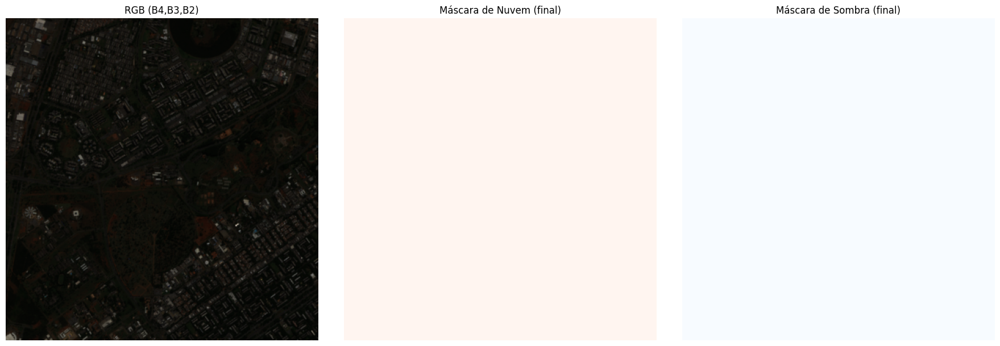

     -> Processando imagem 30/88, ID: S2B_MSIL2A_20210522T133229_N0300_R081_T22LHH_20210522T155748
Generating URL ...
Please wait ...
Data downloaded to c:\Users\arthu\Documents\pibic\data\dataset_sentinel\sentinel_S2B_MSIL2A_20210522T133229_N0300_R081_T22LHH_20210522T155748.tif
       [OK] Imagem salva em: ..\data\dataset_sentinel\sentinel_S2B_MSIL2A_20210522T133229_N0300_R081_T22LHH_20210522T155748.tif


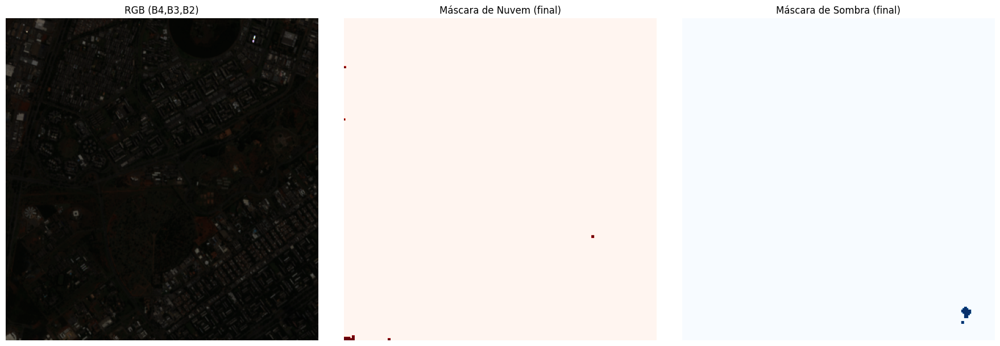

     -> Processando imagem 31/88, ID: S2A_MSIL2A_20210524T132231_N0300_R038_T22LHH_20210524T172436
Generating URL ...
Please wait ...
Data downloaded to c:\Users\arthu\Documents\pibic\data\dataset_sentinel\sentinel_S2A_MSIL2A_20210524T132231_N0300_R038_T22LHH_20210524T172436.tif
       [OK] Imagem salva em: ..\data\dataset_sentinel\sentinel_S2A_MSIL2A_20210524T132231_N0300_R038_T22LHH_20210524T172436.tif


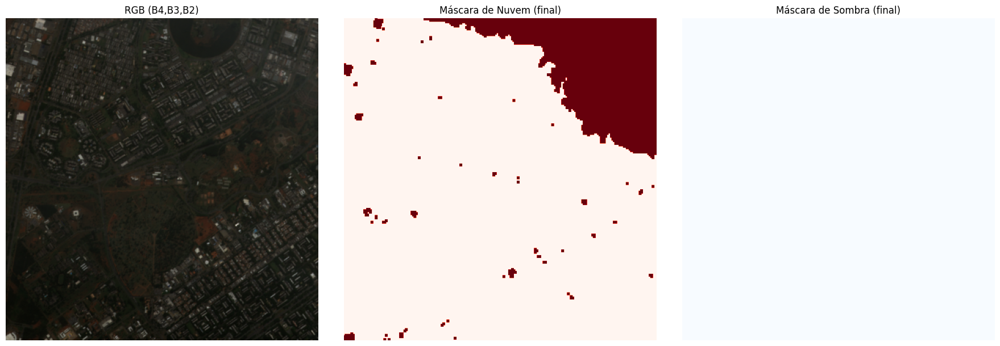

     -> Processando imagem 32/88, ID: S2A_MSIL2A_20210527T133231_N0300_R081_T22LHH_20210527T173815
Generating URL ...
Please wait ...
Data downloaded to c:\Users\arthu\Documents\pibic\data\dataset_sentinel\sentinel_S2A_MSIL2A_20210527T133231_N0300_R081_T22LHH_20210527T173815.tif
       [OK] Imagem salva em: ..\data\dataset_sentinel\sentinel_S2A_MSIL2A_20210527T133231_N0300_R081_T22LHH_20210527T173815.tif


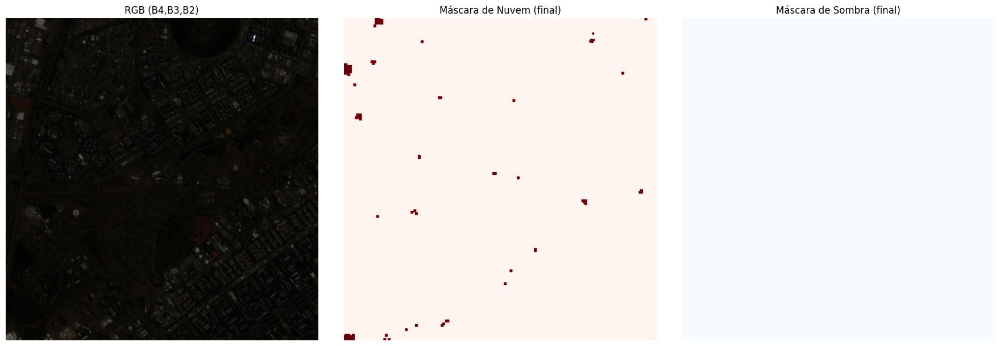

     -> Processando imagem 33/88, ID: S2B_MSIL2A_20210601T133229_N0300_R081_T22LHH_20210601T155500
Generating URL ...
Please wait ...
Data downloaded to c:\Users\arthu\Documents\pibic\data\dataset_sentinel\sentinel_S2B_MSIL2A_20210601T133229_N0300_R081_T22LHH_20210601T155500.tif
       [OK] Imagem salva em: ..\data\dataset_sentinel\sentinel_S2B_MSIL2A_20210601T133229_N0300_R081_T22LHH_20210601T155500.tif


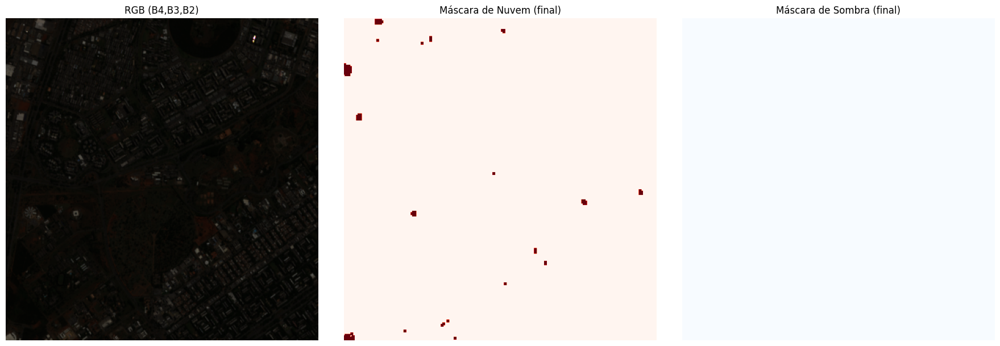

     -> Processando imagem 34/88, ID: S2A_MSIL2A_20210603T132231_N0300_R038_T22LHH_20210603T172949
Generating URL ...
Please wait ...
Data downloaded to c:\Users\arthu\Documents\pibic\data\dataset_sentinel\sentinel_S2A_MSIL2A_20210603T132231_N0300_R038_T22LHH_20210603T172949.tif
       [OK] Imagem salva em: ..\data\dataset_sentinel\sentinel_S2A_MSIL2A_20210603T132231_N0300_R038_T22LHH_20210603T172949.tif


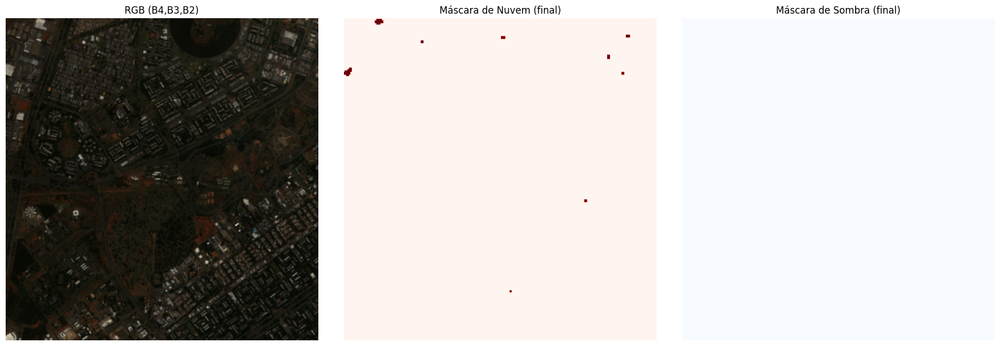

     -> Processando imagem 35/88, ID: S2A_MSIL2A_20210606T133231_N0300_R081_T22LHH_20210606T155300
Generating URL ...
Please wait ...
Data downloaded to c:\Users\arthu\Documents\pibic\data\dataset_sentinel\sentinel_S2A_MSIL2A_20210606T133231_N0300_R081_T22LHH_20210606T155300.tif
       [OK] Imagem salva em: ..\data\dataset_sentinel\sentinel_S2A_MSIL2A_20210606T133231_N0300_R081_T22LHH_20210606T155300.tif


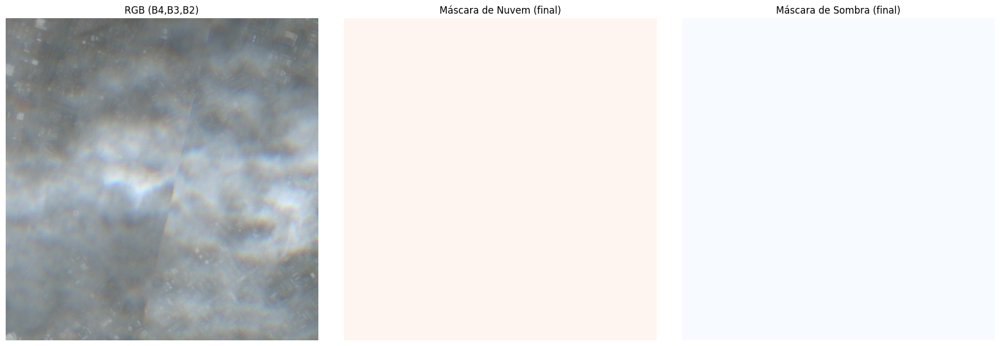

     -> Processando imagem 36/88, ID: S2B_MSIL2A_20210608T132239_N0300_R038_T22LHH_20210608T154244
Generating URL ...
Please wait ...
Data downloaded to c:\Users\arthu\Documents\pibic\data\dataset_sentinel\sentinel_S2B_MSIL2A_20210608T132239_N0300_R038_T22LHH_20210608T154244.tif
       [OK] Imagem salva em: ..\data\dataset_sentinel\sentinel_S2B_MSIL2A_20210608T132239_N0300_R038_T22LHH_20210608T154244.tif


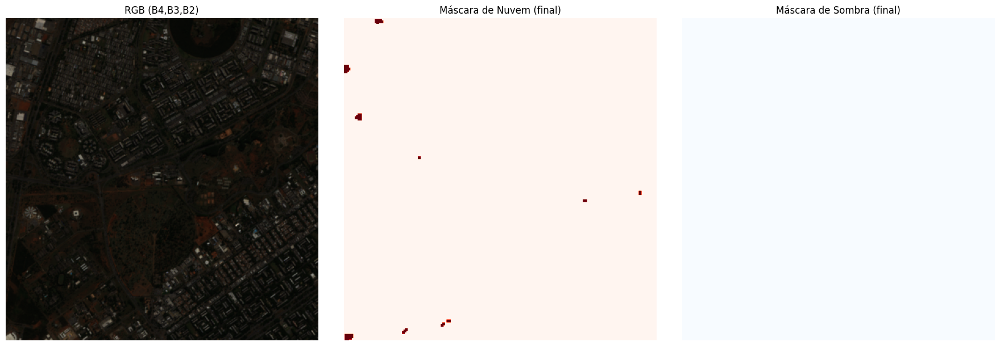

     -> Processando imagem 37/88, ID: S2A_MSIL2A_20210613T132231_N0300_R038_T22LHH_20210613T171719
Generating URL ...
Please wait ...
Data downloaded to c:\Users\arthu\Documents\pibic\data\dataset_sentinel\sentinel_S2A_MSIL2A_20210613T132231_N0300_R038_T22LHH_20210613T171719.tif
       [OK] Imagem salva em: ..\data\dataset_sentinel\sentinel_S2A_MSIL2A_20210613T132231_N0300_R038_T22LHH_20210613T171719.tif


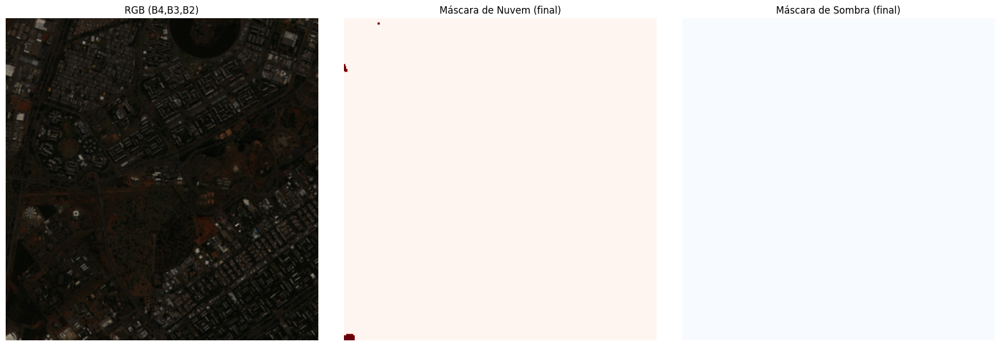

     -> Processando imagem 38/88, ID: S2A_MSIL2A_20210616T133231_N0300_R081_T22LHH_20210616T190042
Generating URL ...
Please wait ...
Data downloaded to c:\Users\arthu\Documents\pibic\data\dataset_sentinel\sentinel_S2A_MSIL2A_20210616T133231_N0300_R081_T22LHH_20210616T190042.tif
       [OK] Imagem salva em: ..\data\dataset_sentinel\sentinel_S2A_MSIL2A_20210616T133231_N0300_R081_T22LHH_20210616T190042.tif


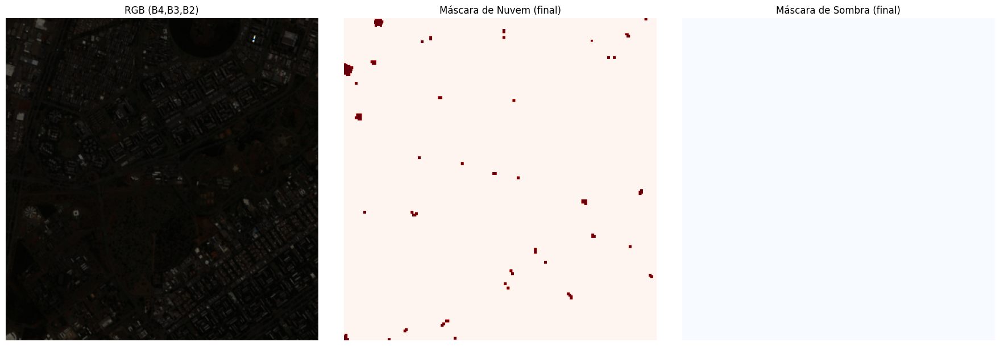

     -> Processando imagem 39/88, ID: S2B_MSIL2A_20210618T132239_N0300_R038_T22LHH_20210618T154245
Generating URL ...
Please wait ...
Data downloaded to c:\Users\arthu\Documents\pibic\data\dataset_sentinel\sentinel_S2B_MSIL2A_20210618T132239_N0300_R038_T22LHH_20210618T154245.tif
       [OK] Imagem salva em: ..\data\dataset_sentinel\sentinel_S2B_MSIL2A_20210618T132239_N0300_R038_T22LHH_20210618T154245.tif


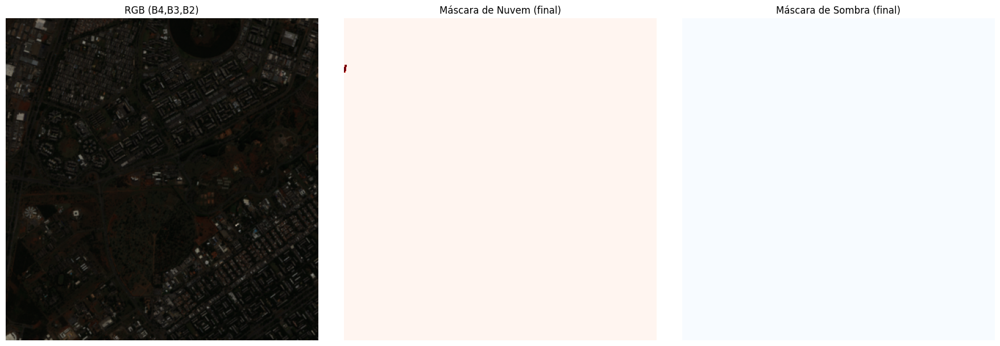

     -> Processando imagem 40/88, ID: S2B_MSIL2A_20210621T133229_N0300_R081_T22LHH_20210621T155140
Generating URL ...
Please wait ...
Data downloaded to c:\Users\arthu\Documents\pibic\data\dataset_sentinel\sentinel_S2B_MSIL2A_20210621T133229_N0300_R081_T22LHH_20210621T155140.tif
       [OK] Imagem salva em: ..\data\dataset_sentinel\sentinel_S2B_MSIL2A_20210621T133229_N0300_R081_T22LHH_20210621T155140.tif


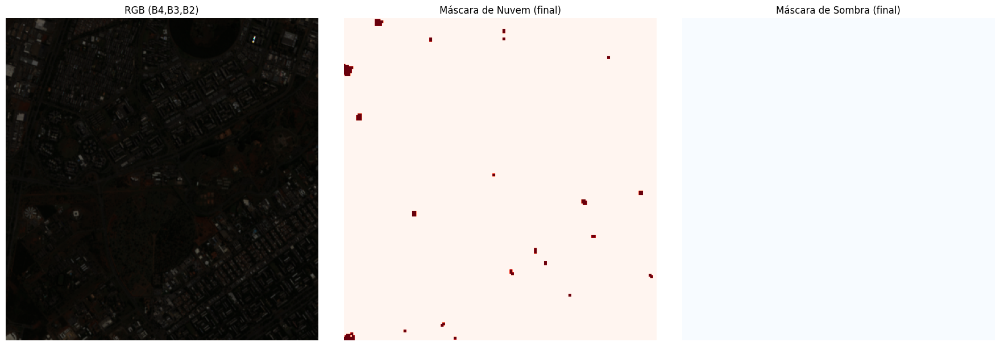

     -> Processando imagem 41/88, ID: S2A_MSIL2A_20210623T132231_N0300_R038_T22LHH_20210623T171937
Generating URL ...
Please wait ...
Data downloaded to c:\Users\arthu\Documents\pibic\data\dataset_sentinel\sentinel_S2A_MSIL2A_20210623T132231_N0300_R038_T22LHH_20210623T171937.tif
       [OK] Imagem salva em: ..\data\dataset_sentinel\sentinel_S2A_MSIL2A_20210623T132231_N0300_R038_T22LHH_20210623T171937.tif


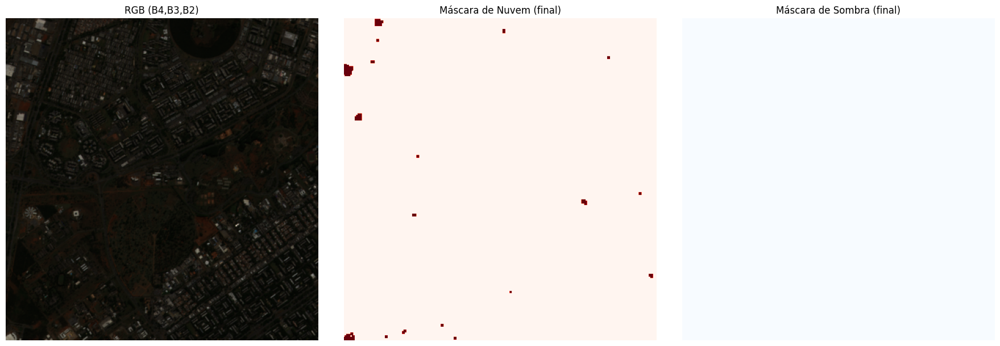

     -> Processando imagem 42/88, ID: S2A_MSIL2A_20210626T133231_N0300_R081_T22LHH_20210626T154540
Generating URL ...
Please wait ...
Data downloaded to c:\Users\arthu\Documents\pibic\data\dataset_sentinel\sentinel_S2A_MSIL2A_20210626T133231_N0300_R081_T22LHH_20210626T154540.tif
       [OK] Imagem salva em: ..\data\dataset_sentinel\sentinel_S2A_MSIL2A_20210626T133231_N0300_R081_T22LHH_20210626T154540.tif


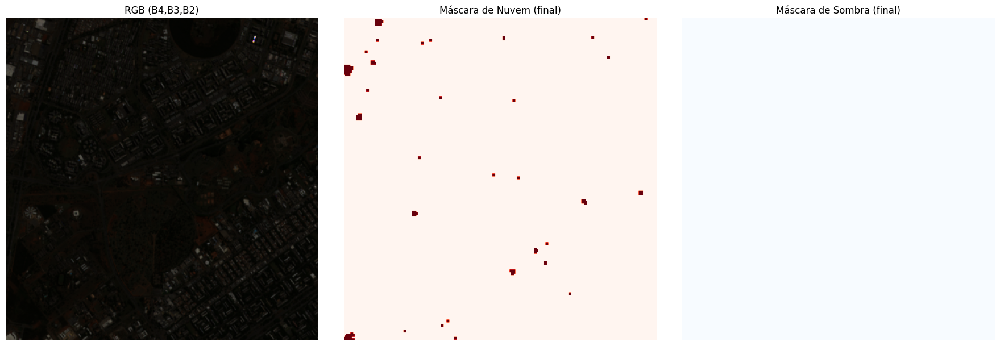

     -> Processando imagem 43/88, ID: S2B_MSIL2A_20210628T132239_N0300_R038_T22LHH_20210628T154958
Generating URL ...


KeyboardInterrupt: 

In [15]:
for idx, aoi in enumerate(aois):
    print(f"\nProcessando AOI {idx+1}/{len(aois)}: {aoi.toGeoJSONString()}")

    # 1) Coleção Sentinel-2 SR
    s2_sr_col = (
        ee.ImageCollection('COPERNICUS/S2_SR')
        .filterBounds(aoi)
        .filterDate('2021-01-01', '2021-12-31')
        .filter(ee.Filter.lt('CLOUDY_PIXEL_PERCENTAGE', 60))  # Filtro inicial
    )

    # 2) Coleção Probability
    s2_cp_col = (
        ee.ImageCollection('COPERNICUS/S2_CLOUD_PROBABILITY')
        .filterBounds(aoi)
        .filterDate('2021-01-01', '2021-12-31')
    )

    # 3) Faz o join das coleções
    merged_collection = merge_s2_and_cloud_prob(s2_sr_col, s2_cp_col)

    # Lista de imagens
    merged_list = merged_collection.toList(merged_collection.size())
    n_images = merged_list.size().getInfo()
    print(f"  -> Total de imagens pareadas = {n_images}")

    for img_idx in range(n_images):
        combined_image = ee.Image(merged_list.get(img_idx))
        # Tenta obter ID
        image_id = combined_image.get('PRODUCT_ID').getInfo()
        if not image_id:
            image_id = combined_image.get('SYSTEM_INDEX').getInfo()

        print(f"     -> Processando imagem {img_idx+1}/{n_images}, ID: {image_id}")

        try:
            # Exporta a imagem + máscaras em uma só vez
            image_file = download_sentinel_image_with_masks(
                image=combined_image,
                aoi=aoi,
                output_dir=dataset_dir,
                image_id=image_id,
                cloud_prob_threshold=50  # Ajuste conforme necessidade
            )
            print(f"       [OK] Imagem salva em: {image_file}")

            # Visualizar e pós-processar localmente
            visualize_masks(image_file, remove_components=True, min_size=10)

        except Exception as e:
            print(f"       [ERRO] ao processar {image_id}: {e}")
            continue